# More data clustering

I want to understand what kind of images we have acording to the standard procedure, for example described [here](http://www.gfmer.ch/ccdc/pdf/module5.pdf). Namely,
do we have images :

- native cervix
- acetic acid
- lugol iodine

of the same patient ?
 


In [16]:
import os
from glob import glob

import numpy as np

TRAIN_DATA = "../input/train"
type_1_files = glob(os.path.join(TRAIN_DATA, "Type_1", "*.jpg"))
type_1_ids = np.array([s[len(os.path.join(TRAIN_DATA, "Type_1"))+1:-4] for s in type_1_files])
type_2_files = glob(os.path.join(TRAIN_DATA, "Type_2", "*.jpg"))
type_2_ids = np.array([s[len(os.path.join(TRAIN_DATA, "Type_2"))+1:-4] for s in type_2_files])
type_3_files = glob(os.path.join(TRAIN_DATA, "Type_3", "*.jpg"))
type_3_ids = np.array([s[len(os.path.join(TRAIN_DATA, "Type_3"))+1:-4] for s in type_3_files])

print("Train data")
print(len(type_1_files), len(type_2_files), len(type_3_files))
print("Type 1", type_1_ids[:10])
print("Type 2", type_2_ids[:10])
print("Type 3", type_3_ids[:10])

ADDITIONAL_DATA = "../input/additional"
additional_type_1_files = glob(os.path.join(ADDITIONAL_DATA, "Type_1", "*.jpg"))
additional_type_1_ids = np.array([s[len(os.path.join(ADDITIONAL_DATA, "Type_1"))+1:-4] for s in additional_type_1_files])
additional_type_2_files = glob(os.path.join(ADDITIONAL_DATA, "Type_2", "*.jpg"))
additional_type_2_ids = np.array([s[len(os.path.join(ADDITIONAL_DATA, "Type_2"))+1:-4] for s in additional_type_2_files])
additional_type_3_files = glob(os.path.join(ADDITIONAL_DATA, "Type_3", "*.jpg"))
additional_type_3_ids = np.array([s[len(os.path.join(ADDITIONAL_DATA, "Type_3"))+1:-4] for s in additional_type_3_files])

print("Additional data")
print(len(additional_type_1_files), len(additional_type_2_files), len(additional_type_2_files))
print("Type 1", additional_type_1_ids[:10])
print("Type 2", additional_type_2_ids[:10])
print("Type 3", additional_type_3_ids[:10])



def get_filename(image_id, image_type):
    """
    Method to get image file path from its id and type   
    """
    if image_type == "Type_1" or \
        image_type == "Type_2" or \
        image_type == "Type_3":
        data_path = os.path.join(TRAIN_DATA, image_type)
    elif image_type == "Test":
        data_path = TEST_DATA
    elif image_type == "AType_1" or \
          image_type == "AType_2" or \
          image_type == "AType_3":
        data_path = os.path.join(ADDITIONAL_DATA, image_type[1:])
    else:
        raise Exception("Image type '%s' is not recognized" % image_type)

    ext = 'jpg'
    return os.path.join(data_path, "{}.{}".format(image_id, ext))


def get_image_data(image_id, image_type):
    """
    Method to get image data as np.array specifying image id and type
    """
    fname = get_filename(image_id, image_type)
    img = cv2.imread(fname)
    assert img is not None, "Failed to read image : %s, %s" % (image_id, image_type)
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    return img


import matplotlib.pylab as plt
%matplotlib inline

def plt_st(l1,l2):
    plt.figure(figsize=(l1,l2))


Train data
250 781 450
Type 1 ['0' '10' '1013' '1014' '1019' '102' '1023' '1024' '1026' '1027']
Type 2 ['1' '100' '1001' '1002' '1005' '1006' '101' '1010' '1011' '1012']
Type 3 ['1000' '1003' '1004' '1007' '1008' '1009' '1015' '1020' '1028' '1029']
Additional data
1191 0 0
Type 1 ['10' '1000' '1001' '1003' '1004' '1005' '1009' '1011' '102' '1032']
Type 2 []
Type 3 ['100' '1010' '1012' '1014' '1019' '1021' '1027' '1041' '1048' '1051']


Idea is to use clustering on images of one type to group data


In [2]:
def compute_histogram(img, hist_size=100):
    hist = cv2.calcHist([img], [0], mask=None, histSize=[hist_size], ranges=(0, 255))
    hist = cv2.normalize(hist, dst=hist)
    return hist

In [3]:
type_ids=(type_2_ids,)
image_types = ["Type_2",]
ll = [int(len(ids)) for ids in type_ids]

id_type_list = []
for ids, image_type in zip(type_ids, image_types):
    for image_id in ids:
        id_type_list.append((image_id, image_type))

In [4]:
print("Total number of images: ", len(id_type_list))
# Find empty images:
empty_images = []
for image_id, image_type in id_type_list:
    size = os.path.getsize(get_filename(image_id, image_type))
    if size == 0:
        empty_images.append((image_id, image_type))
print("Number of empty images: ", len(empty_images))

Total number of images:  781
Number of empty images:  0


In [5]:
# Remove empty images from id_type_list
for image_id, image_type in empty_images:
    id_type_list.remove((image_id, image_type))

In [6]:
import cv2

In [7]:
RESIZED_IMAGES = {}

In [8]:

image_size = (256, 256)
center = (image_size[0]//2, image_size[1]//2)
hist_size = 100
margin = 22

n_features = 3*4 + hist_size
X = np.zeros((len(id_type_list), n_features), dtype=np.float32)
for i, (image_id, image_type) in enumerate(id_type_list):
    key = (image_id, image_type)
    if key in RESIZED_IMAGES:
        img = RESIZED_IMAGES[key]
    else:
        img = get_image_data(image_id, image_type)
        img = cv2.resize(img, dsize=image_size[::-1])    
        RESIZED_IMAGES[key] = img
    hsv = cv2.cvtColor(img, cv2.COLOR_RGB2HSV)
    hue = hsv[:,:,0]
    sat = hsv[:,:,1]
    hist_hue = compute_histogram(hue, hist_size)
    hist_sat = compute_histogram(sat, hist_size)    
    hist = hist_hue + hist_sat
    
    X[i, 0:3] = np.mean(img, axis=(0, 1))
    X[i, 3:6] = np.std(img, axis=(0, 1))    
    #X[i, 6] = np.mean(hue, axis=(0, 1))       
    X[i, 6:9] = 0.25*(np.mean(img[0:margin, :], axis=(0, 1)) + \
                 np.mean(img[:, 0:margin, :], axis=(0, 1)) + \
                 np.mean(img[-margin:, :, :], axis=(0, 1)) + \
                 np.mean(img[:, -margin:, :], axis=(0, 1)))
    X[i, 9:12] = np.mean(img[center[0]-margin:center[0]+margin, center[1]-margin:center[1]+margin, :], axis=(0, 1))
    X[i, 12:] = hist[:,0]

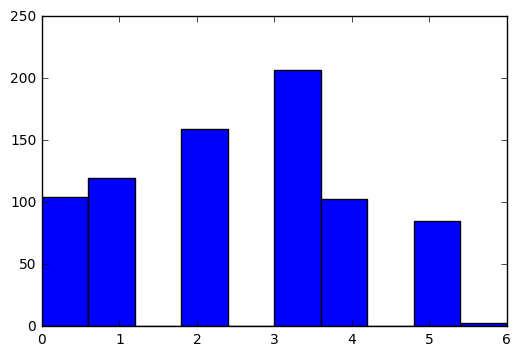

In [17]:
np_classes = 7

from sklearn.cluster import KMeans
kmeans = KMeans(n_clusters=np_classes)
kmeans.fit(X)
y_kmeans = kmeans.predict(X)
_ = plt.hist(y_kmeans)



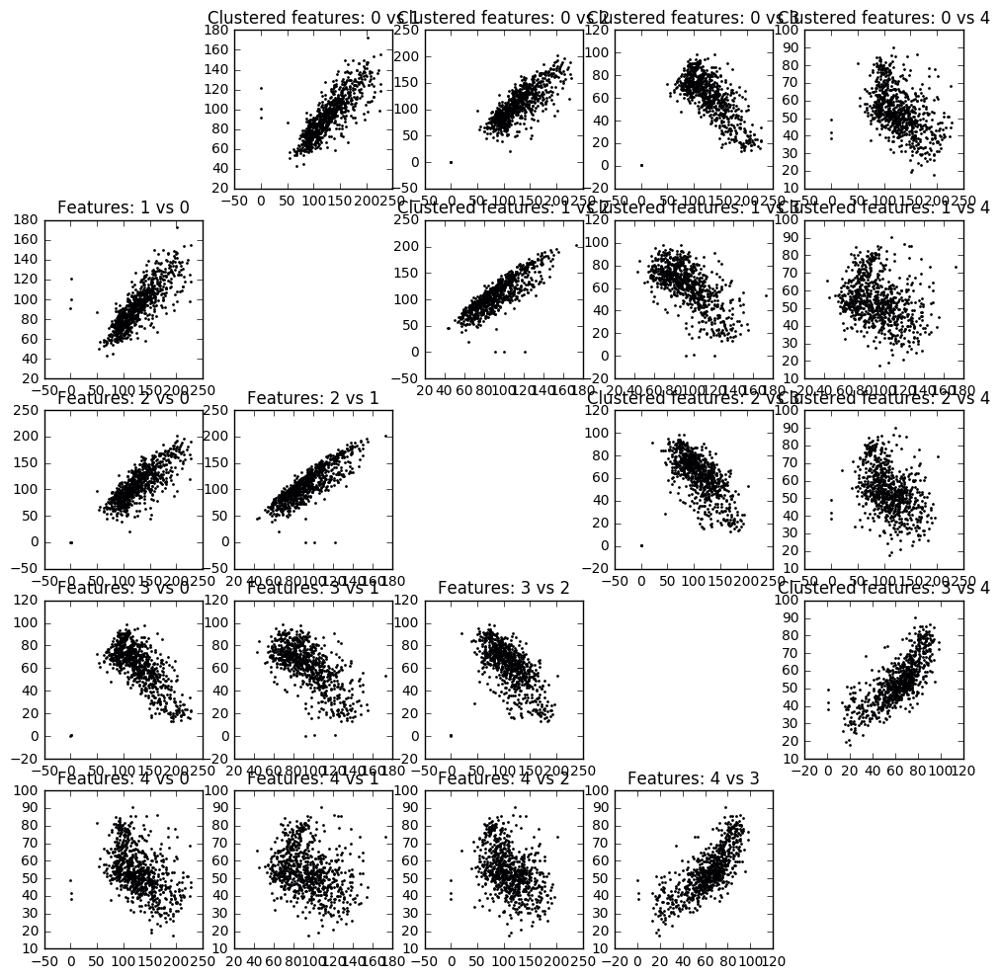

In [18]:
plt_st(12, 12)
n = 5
counter = 0
for i in range(n):
    for j in range(n):
        counter += 1
        if i == j:
            continue 
            
        if i > j:
            plt.subplot(n, n, counter)                
            plt.title("Features: %i vs %i" % (i, j))
            plt.scatter(X[:, j], X[:, i], s=1, cmap='viridis')
            continue

        plt.subplot(n, n, counter)                
        plt.title("Clustered features: %i vs %i" % (i, j))
        for class_index in range(np_classes):
            class_indices = np.where(y_kmeans == class_index)[0]
            plt.scatter(X[class_indices, i], X[class_indices, j], s=1, label='class %i' % class_index, cmap='viridis')

In [19]:
all_classes_images = []

for class_index in range(np_classes):    
    class_indices = np.where(y_kmeans == class_index)[0]
    n = 10    
    m = int(np.ceil(len(class_indices) / n)) 
    one_class_image = np.zeros((m*(image_size[0]+2), n*(image_size[1]+2), 3), dtype=np.uint8)    
    
    counter = 0
    for i in range(m):
        ys = i*(image_size[1] + 2)
        ye = ys + image_size[1]
        for j in range(n):
            xs = j*(image_size[0] + 2)
            xe = xs + image_size[0]
            if counter == len(class_indices):
                break
            image_id, image_type = id_type_list[class_indices[counter]]; counter+=1
            key = (image_id, image_type)
            assert key in RESIZED_IMAGES, "WTF"
            img = RESIZED_IMAGES[key]                
            img = cv2.putText(img, image_id + ' | ' + str(image_type) + ' | ' + str(class_index), (5,img.shape[0] - 5), cv2.FONT_HERSHEY_SIMPLEX, 1.0, (255, 255, 255), thickness=2)
            one_class_image[ys:ye, xs:xe, :] = img[:,:,:]

        if counter == len(class_indices):
            break
    
    all_classes_images.append(one_class_image)

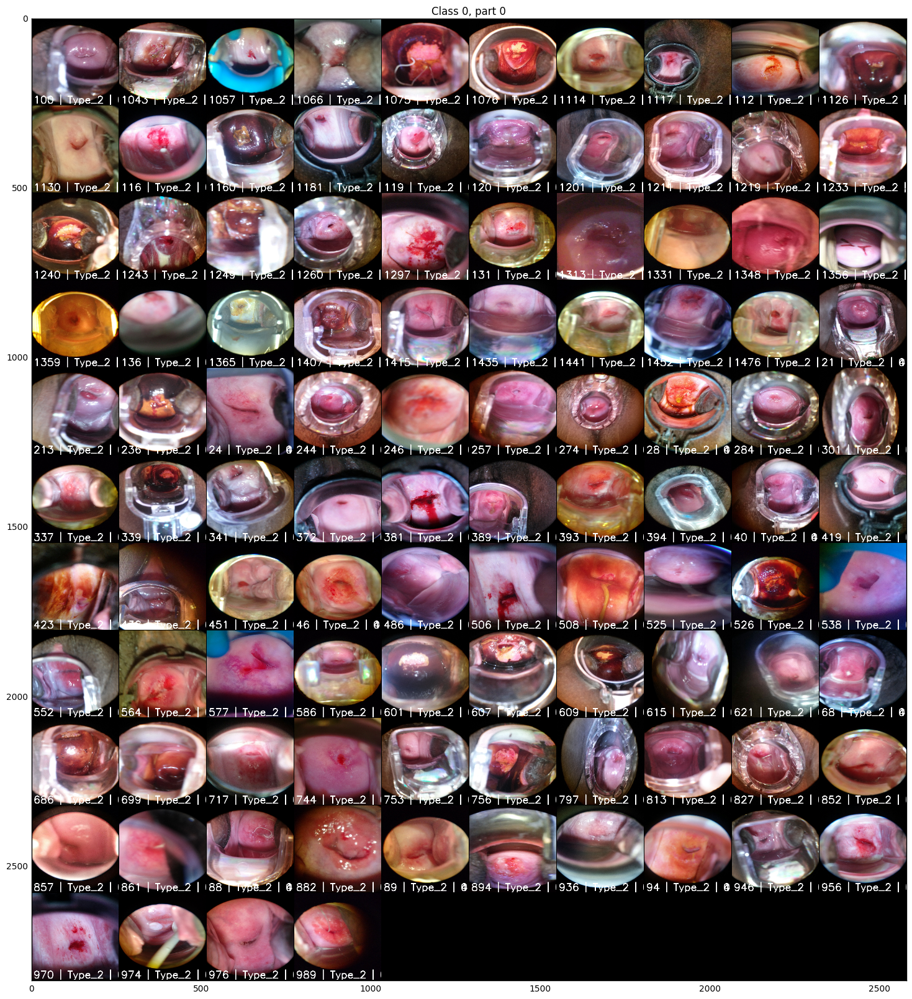

In [20]:
class_index = 0

m = all_classes_images[class_index].shape[0] / (image_size[0] + 2)
n = int(np.ceil(m / 15.0))
for i in range(n):
    plt_st(20, 20)
    ys = i*(image_size[0] + 2)*15
    ye = min((i+1)*(image_size[0] + 2)*15, all_classes_images[class_index].shape[0])
    plt.imshow(all_classes_images[class_index][ys:ye,:,:])
    plt.title("Class %i, part %i" % (class_index, i))

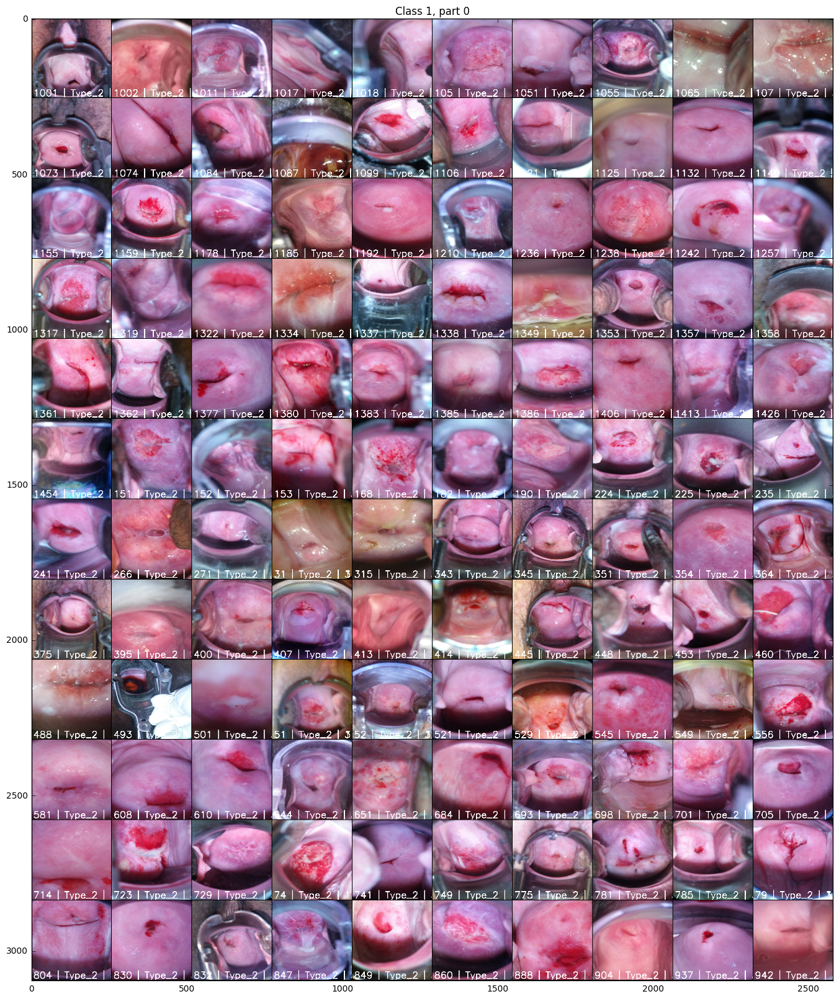

In [21]:
class_index = 1

m = all_classes_images[class_index].shape[0] / (image_size[0] + 2)
n = int(np.ceil(m / 15.0))
for i in range(n):
    plt_st(20, 20)
    ys = i*(image_size[0] + 2)*15
    ye = min((i+1)*(image_size[0] + 2)*15, all_classes_images[class_index].shape[0])
    plt.imshow(all_classes_images[class_index][ys:ye,:,:])
    plt.title("Class %i, part %i" % (class_index, i))

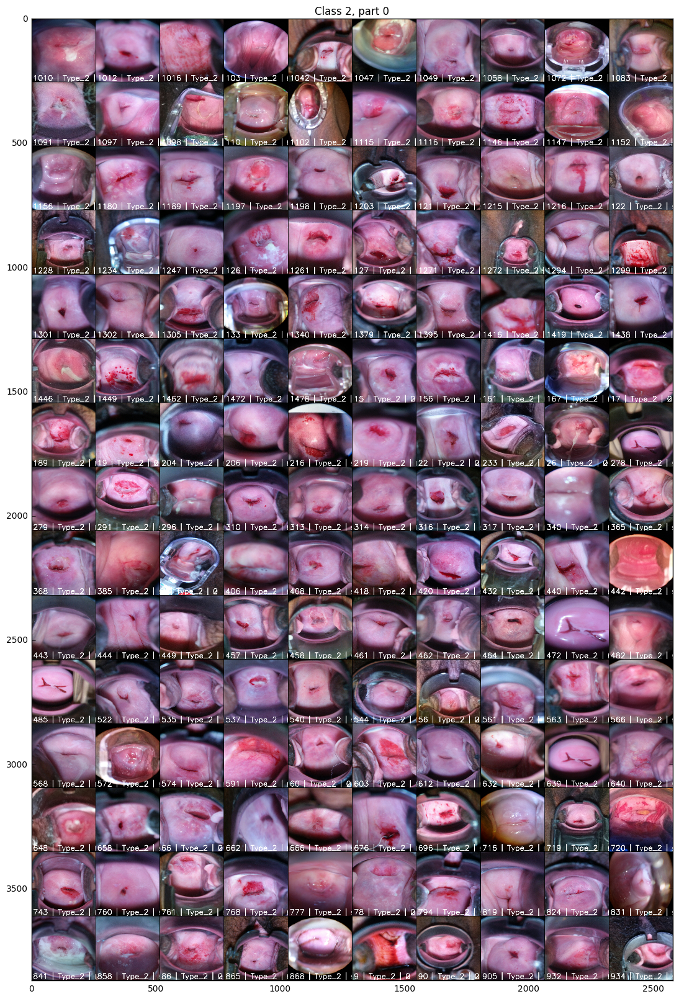

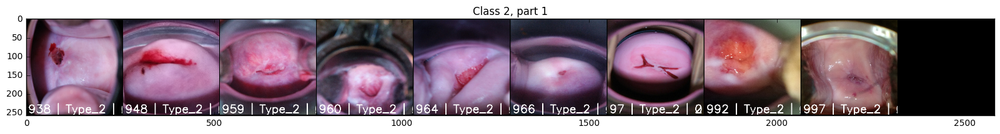

In [22]:
class_index = 2

m = all_classes_images[class_index].shape[0] / (image_size[0] + 2)
n = int(np.ceil(m / 15.0))
for i in range(n):
    plt_st(20, 20)
    ys = i*(image_size[0] + 2)*15
    ye = min((i+1)*(image_size[0] + 2)*15, all_classes_images[class_index].shape[0])
    plt.imshow(all_classes_images[class_index][ys:ye,:,:])
    plt.title("Class %i, part %i" % (class_index, i))

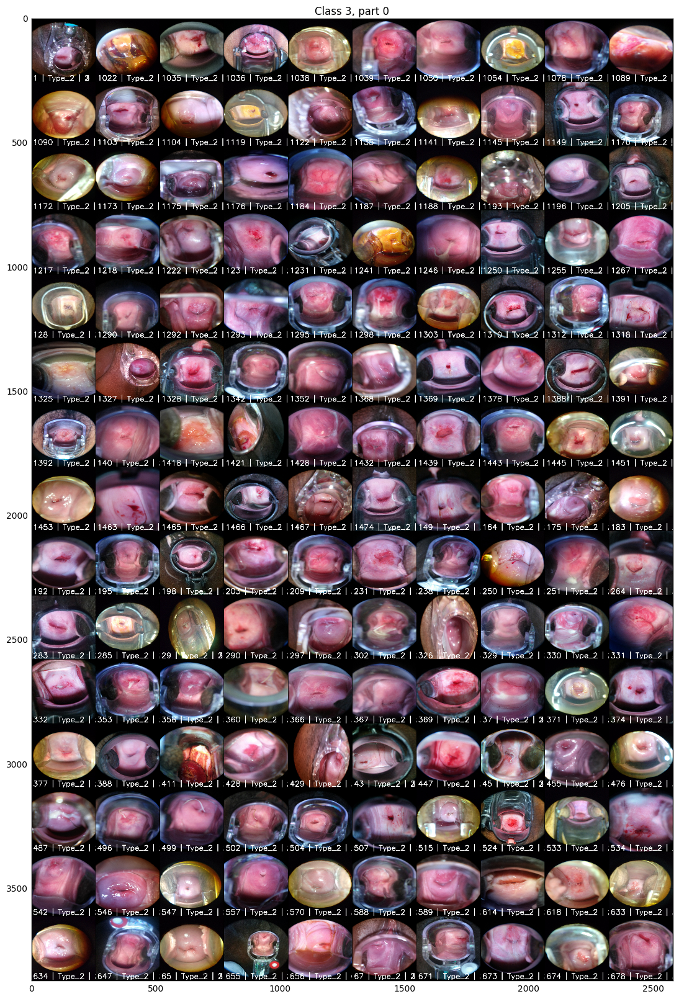

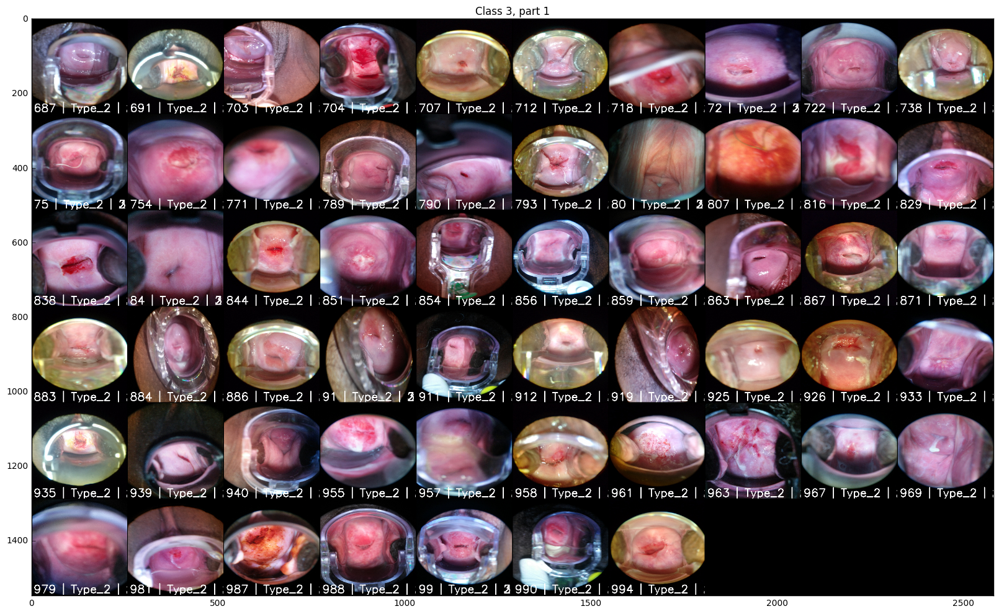

In [23]:
class_index = 3

m = all_classes_images[class_index].shape[0] / (image_size[0] + 2)
n = int(np.ceil(m / 15.0))
for i in range(n):
    plt_st(20, 20)
    ys = i*(image_size[0] + 2)*15
    ye = min((i+1)*(image_size[0] + 2)*15, all_classes_images[class_index].shape[0])
    plt.imshow(all_classes_images[class_index][ys:ye,:,:])
    plt.title("Class %i, part %i" % (class_index, i))

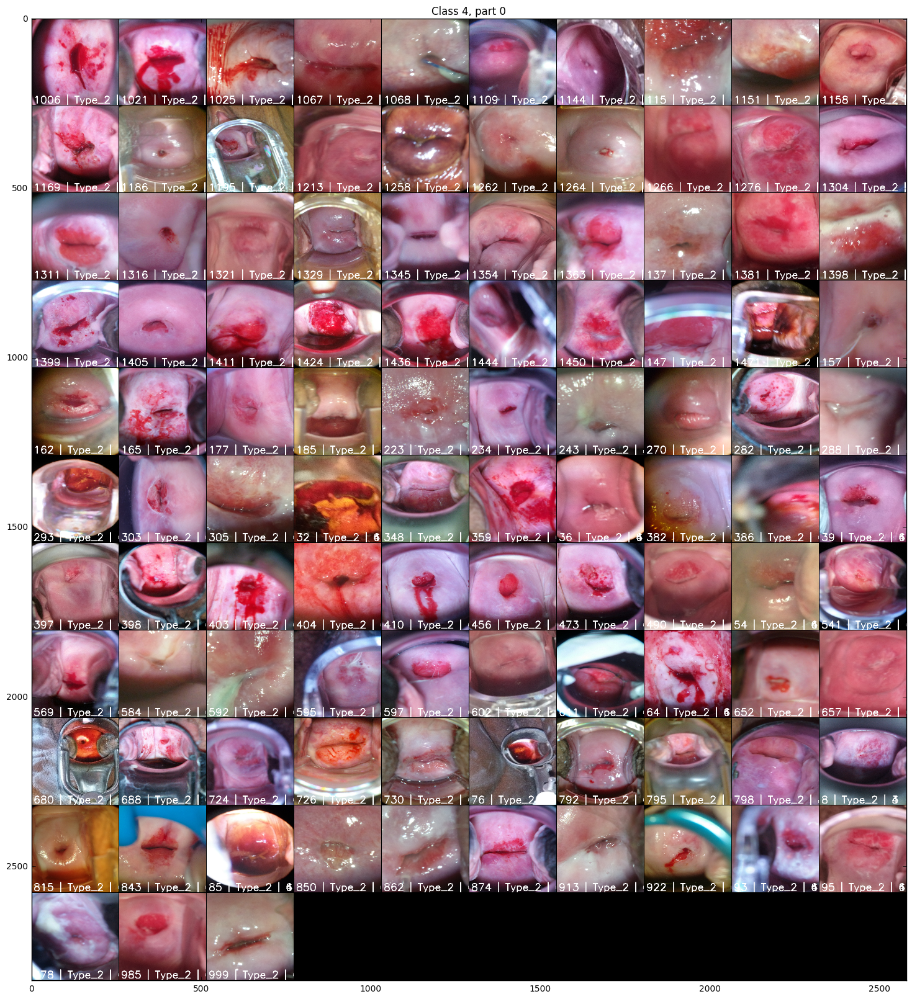

In [24]:
class_index = 4

m = all_classes_images[class_index].shape[0] / (image_size[0] + 2)
n = int(np.ceil(m / 15.0))
for i in range(n):
    plt_st(20, 20)
    ys = i*(image_size[0] + 2)*15
    ye = min((i+1)*(image_size[0] + 2)*15, all_classes_images[class_index].shape[0])
    plt.imshow(all_classes_images[class_index][ys:ye,:,:])
    plt.title("Class %i, part %i" % (class_index, i))

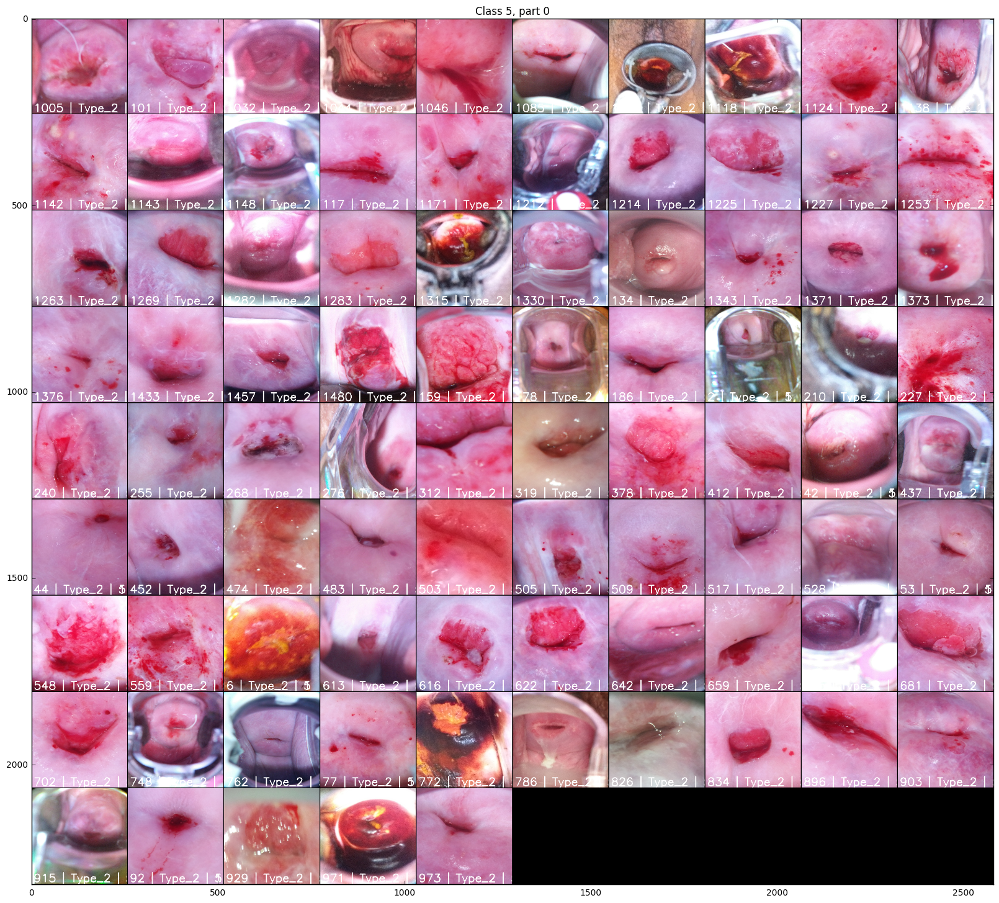

In [25]:
class_index = 5

m = all_classes_images[class_index].shape[0] / (image_size[0] + 2)
n = int(np.ceil(m / 15.0))
for i in range(n):
    plt_st(20, 20)
    ys = i*(image_size[0] + 2)*15
    ye = min((i+1)*(image_size[0] + 2)*15, all_classes_images[class_index].shape[0])
    plt.imshow(all_classes_images[class_index][ys:ye,:,:])
    plt.title("Class %i, part %i" % (class_index, i))

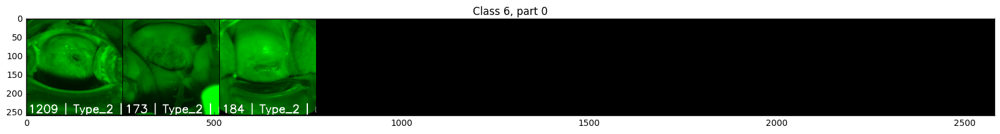

In [26]:
class_index = 6

m = all_classes_images[class_index].shape[0] / (image_size[0] + 2)
n = int(np.ceil(m / 15.0))
for i in range(n):
    plt_st(20, 20)
    ys = i*(image_size[0] + 2)*15
    ye = min((i+1)*(image_size[0] + 2)*15, all_classes_images[class_index].shape[0])
    plt.imshow(all_classes_images[class_index][ys:ye,:,:])
    plt.title("Class %i, part %i" % (class_index, i))